In [1]:
from kaggle_environments import make
import yaml
from IPython.display import HTML
from src.wrapper import DifficultyWrapper

## 任意のチームで対戦

In [2]:
# config(agentのpathを含む)
with open('config.yaml') as file:
    config = yaml.safe_load(file)

In [3]:
# チームを選択して対戦
def play_game(right_team, left_team): 
    env = make("football", debug=True,
               configuration={"save_video": True, 
                              "scenario_name": "11_vs_11_kaggle", 
                              "running_in_notebook": True})
    
    # env = DifficultyWrapper(env, initial_difficulty=1.0)
    output = env.run([right_team, left_team])
    scores = output[-1][0]["observation"]["players_raw"][0]["score"]
    print("Scores  {0} : {1}".format(*scores))
    return output, scores, env

In [4]:
# 10試合対戦
# for i in range(10):
#     _, _, _ = play_game(config["kutopon"], config["beast1"])

In [5]:
output, scores, env = play_game(config["kutopon"], config["beast1"])

Staring a new environment 20b15d26-dea1-440e-b543-5c0b90ce4438: with scenario: 11_vs_11_kaggle
Resetting environment 20b15d26-dea1-440e-b543-5c0b90ce4438: with scenario: 11_vs_11_kaggle
Received video link.
Scores  1 : 4


In [6]:
# 試合の様子を可視化
env.render(mode="human", width=800, height=600)

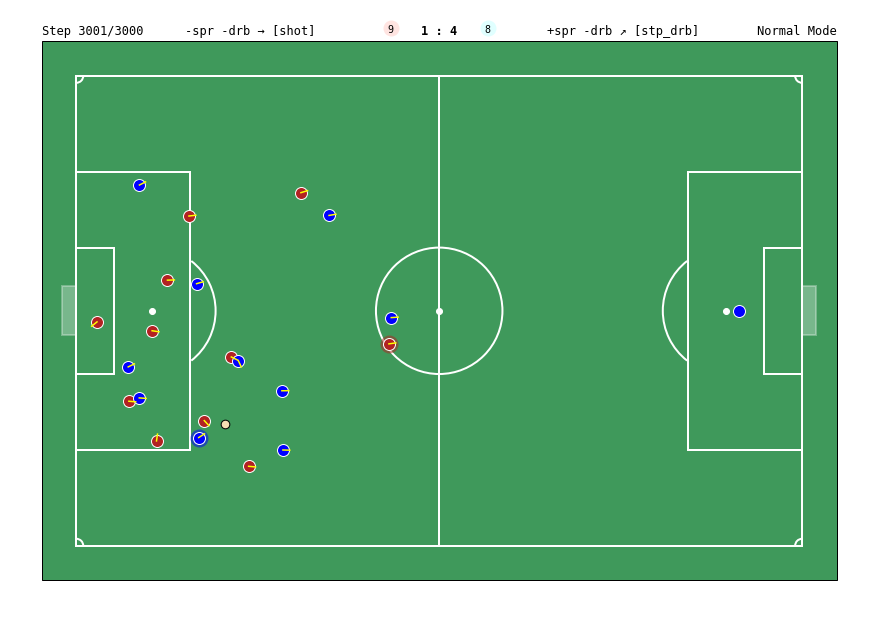

In [7]:
# 試合の様子を可視化2
from src.visualizer import visualize
from IPython.display import HTML
viz = visualize(output)
HTML(viz.to_html5_video())

## outputからlog取得

In [8]:
# action名とnumberを対応づける
actions_dict = {
    0:"idle",
    1:"left",
    2:"top_left",
    3:"top",
    4:"top_right",
    5:"right",
    6:"bottom_right",
    7:"bottom",
    8:"bottom_left",
    9:"long_pass",
    10:"high_pass",
    11:"short_pass",
    12:"shot",
    13:"sprint",
    14:"release_direction",
    15:"release_sprint",
    16:"sliding",
    17:"dribble",
    18:"release_dribble",    
}

actions_dict_inverse = {v: k for k, v in actions_dict.items()}
actions_name = list(actions_dict.values())

In [9]:
import numpy as np

# 必要そうな情報をoutput logから取得
def output_to_df(output):
    info_dict = {
        "game_mode":[],
        "ball_owned_player":[],
        "ball_owned_team": [],
        "left_action": [],
        "left_mean_tired":[],
        "left_player0_x":[],
        "left_player1_x":[],
        "left_player2_x":[],
        "left_player3_x":[],
        "left_player4_x":[],
        "left_player5_x":[],
        "left_player6_x":[],
        "left_player7_x":[],
        "left_player8_x":[],
        "left_player9_x":[],
        "left_player10_x":[],
        "left_player0_y":[],
        "left_player1_y":[],
        "left_player2_y":[],
        "left_player3_y":[],
        "left_player4_y":[],
        "left_player5_y":[],
        "left_player6_y":[],
        "left_player7_y":[],
        "left_player8_y":[],
        "left_player9_y":[],
        "left_player10_y":[],
        "left_num_yellow_card":[],
        "left_num_red_card":[],
        "right_action": [],
        "right_mean_tired":[],
        "right_player0_x":[],
        "right_player1_x":[],
        "right_player2_x":[],
        "right_player3_x":[],
        "right_player4_x":[],
        "right_player5_x":[],
        "right_player6_x":[],
        "right_player7_x":[],
        "right_player8_x":[],
        "right_player9_x":[],
        "right_player10_x":[],
        "right_player0_y":[],
        "right_player1_y":[],
        "right_player2_y":[],
        "right_player3_y":[],
        "right_player4_y":[],
        "right_player5_y":[],
        "right_player6_y":[],
        "right_player7_y":[],
        "right_player8_y":[],
        "right_player9_y":[],
        "right_player10_y":[],
        "right_num_yellow_card":[],
        "right_num_red_card":[],
        "ball_x":[],
        "ball_y":[],
        "ball_z":[],
    }

    for i in range(1,3001,1):
        
        obs = output[i][0]["observation"]["players_raw"][0]
        info_dict["game_mode"].append(obs["game_mode"])
        info_dict["ball_x"].append(obs["ball"][0])
        info_dict["ball_y"].append(obs["ball"][1])
        info_dict["ball_z"].append(obs["ball"][2])
        info_dict["ball_owned_player"].append(obs['ball_owned_player'])
        info_dict["ball_owned_team"].append(obs['ball_owned_team'])
        
        info_dict["left_mean_tired"].append(np.mean(obs["left_team_tired_factor"]))
        info_dict["left_action"].append(output[i][0]["action"][0])
        

        left = obs['left_team']
        info_dict["left_player0_x"].append(left[0][0])
        info_dict["left_player1_x"].append(left[1][0])
        info_dict["left_player2_x"].append(left[2][0])
        info_dict["left_player3_x"].append(left[3][0])
        info_dict["left_player4_x"].append(left[4][0])
        info_dict["left_player5_x"].append(left[5][0])
        info_dict["left_player6_x"].append(left[6][0])
        info_dict["left_player7_x"].append(left[7][0])
        info_dict["left_player8_x"].append(left[8][0])
        info_dict["left_player9_x"].append(left[9][0])
        info_dict["left_player10_x"].append(left[10][0])
        info_dict["left_player0_y"].append(left[0][1])
        info_dict["left_player1_y"].append(left[1][1])
        info_dict["left_player2_y"].append(left[2][1])
        info_dict["left_player3_y"].append(left[3][1])
        info_dict["left_player4_y"].append(left[4][1])
        info_dict["left_player5_y"].append(left[5][1])
        info_dict["left_player6_y"].append(left[6][1])
        info_dict["left_player7_y"].append(left[7][1])
        info_dict["left_player8_y"].append(left[8][1])
        info_dict["left_player9_y"].append(left[9][1])
        info_dict["left_player10_y"].append(left[10][1])
        info_dict["left_num_yellow_card"].append(obs["left_team_yellow_card"].count(True))
        info_dict["left_num_red_card"].append(obs["left_team_active"].count(False))
        
        
        info_dict["right_mean_tired"].append(np.mean(obs["right_team_tired_factor"]))
        info_dict["right_action"].append(output[i][1]["action"][0])
        right = obs['right_team']
        info_dict["right_player0_x"].append(right[0][0])
        info_dict["right_player1_x"].append(right[1][0])
        info_dict["right_player2_x"].append(right[2][0])
        info_dict["right_player3_x"].append(right[3][0])
        info_dict["right_player4_x"].append(right[4][0])
        info_dict["right_player5_x"].append(right[5][0])
        info_dict["right_player6_x"].append(right[6][0])
        info_dict["right_player7_x"].append(right[7][0])
        info_dict["right_player8_x"].append(right[8][0])
        info_dict["right_player9_x"].append(right[9][0])
        info_dict["right_player10_x"].append(right[10][0])
        info_dict["right_player0_y"].append(right[0][1])
        info_dict["right_player1_y"].append(right[1][1])
        info_dict["right_player2_y"].append(right[2][1])
        info_dict["right_player3_y"].append(right[3][1])
        info_dict["right_player4_y"].append(right[4][1])
        info_dict["right_player5_y"].append(right[5][1])
        info_dict["right_player6_y"].append(right[6][1])
        info_dict["right_player7_y"].append(right[7][1])
        info_dict["right_player8_y"].append(right[8][1])
        info_dict["right_player9_y"].append(right[9][1])
        info_dict["right_player10_y"].append(right[10][1])
        info_dict["right_num_yellow_card"].append(obs["right_team_yellow_card"].count(True))
        info_dict["right_num_red_card"].append(obs["right_team_active"].count(False))
        
    info_df = pd.DataFrame(info_dict)
    
    return info_df

In [10]:
import pandas as pd

df = output_to_df(output)
df

,game_mode,ball_owned_player,ball_owned_team,left_action,left_mean_tired,left_player0_x,left_player1_x,left_player2_x,left_player3_x,left_player4_x,...,right_player6_y,right_player7_y,right_player8_y,right_player9_y,right_player10_y,right_num_yellow_card,right_num_red_card,ball_x,ball_y,ball_z
0,0,-1,-1,9,0.000025,-1.011029,-0.048873,-0.010518,-0.425609,-0.504316,...,-0.198449,0.107410,-0.000002,-0.107401,0.219569,0,0,0.000000,-0.000000,0.110597
1,0,-1,-1,7,0.000134,-1.008168,-0.044333,-0.012802,-0.422351,-0.501418,...,-0.196847,0.107383,-0.000024,-0.107403,0.218362,0,0,0.000000,-0.000000,0.109301
2,0,-1,-1,7,0.000323,-1.003107,-0.038062,-0.015672,-0.418275,-0.497249,...,-0.194702,0.107045,-0.000085,-0.107117,0.215497,0,0,0.000000,-0.000000,0.110755
3,0,1,1,9,0.000572,-0.996458,-0.030385,-0.018933,-0.413417,-0.492006,...,-0.192048,0.106366,-0.000161,-0.106434,0.211509,0,0,0.000886,-0.001259,0.108019
4,0,1,1,4,0.000873,-0.988375,-0.022870,-0.022596,-0.407732,-0.485870,...,-0.188927,0.105488,-0.000221,-0.105536,0.206536,0,0,0.002539,-0.003604,0.109012
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,0,-1,-1,6,0.164437,-0.961198,-0.712730,-0.607731,-0.859401,-0.580368,...,0.082671,-0.030471,0.234377,0.152186,-0.197816,1,0,-0.661492,0.185347,1.030329
2996,0,-1,-1,10,0.164768,-0.951122,-0.705024,-0.602329,-0.846005,-0.570462,...,0.081178,-0.033982,0.233776,0.152613,-0.203422,1,0,-0.656313,0.189498,0.954186
2997,0,-1,-1,5,0.165082,-0.942755,-0.702747,-0.595940,-0.832429,-0.559780,...,0.080387,-0.037601,0.233612,0.153208,-0.209371,1,0,-0.651161,0.193616,0.780622
2998,0,-1,-1,15,0.165392,-0.939823,-0.700398,-0.588770,-0.818708,-0.548892,...,0.082133,-0.041279,0.232241,0.153968,-0.215177,1,0,-0.646041,0.197697,0.510405


In [11]:
# 一度も選択していない行動を確認
for i in range(19):
    if i not in (df['right_action'].value_counts().index):
        
        print(f"right:{i}")
        
    if i not in (df['left_action'].value_counts().index):
        print(f"left:{i}")

right:17


## 試合の基本情報

In [12]:
# 試合の基本情報を取得するdataframeを作成
# スコア
game = pd.DataFrame(scores, index=['left team', 'right team'], columns=['スコア'])

# カード
left_yellow_card = df["left_num_yellow_card"].max()
left_red_card = df["left_num_red_card"].max()
right_yellow_card = df["right_num_yellow_card"].max()
right_red_card = df["right_num_red_card"].max()
game['イエローカード数'] = [left_yellow_card, right_yellow_card]
game['レッドカード数'] = [left_red_card, right_yellow_card]

# ボール支配率
right_owned_count = len(df[df["ball_owned_team"]==1])
left_owned_count = len(df[df["ball_owned_team"]==0])
right_owned_rate = right_owned_count / (right_owned_count + left_owned_count)
left_owned_rate = 1 - right_owned_rate
game['ボール支配率'] = [np.round(left_owned_rate*100, 1), np.round(right_owned_rate*100, 1)]

# game_mode:2 = GoalKick
GK = df[df["game_mode"].isin([2])]
game['ゴールキック数'] = [len(GK[GK['ball_x'] < 0]), len(GK[GK['ball_x'] > 0])]

# game_mode:4 = CornerKick
CK = df[df["game_mode"].isin([4])]
game['コーナーキック数'] = [len(CK[CK['ball_x'] > 0]), len(CK[CK['ball_x'] < 0])]
game.T

,left team,right team
スコア,1.0,4.0
イエローカード数,1.0,1.0
レッドカード数,0.0,1.0
ボール支配率,38.3,61.7
ゴールキック数,0.0,12.0
コーナーキック数,0.0,26.0


In [13]:
df["left_ball_owned_player"] = -1
df["right_ball_owned_player"] = -1
df["left_ball_owned_player"] = df.loc[df["ball_owned_team"]==0, "ball_owned_player"]
df["right_ball_owned_player"] = df.loc[df["ball_owned_team"]==1, "ball_owned_player"]
df['left_ball_owned_player2'] = df['left_ball_owned_player'].shift(1)
df['right_ball_owned_player2'] = df['right_ball_owned_player'].shift(1)

# game_mode:3 = FreeKick
FK = df[df["game_mode"].isin([3])]
FK_left = FK[(FK['left_ball_owned_player']!=-1)|(FK['left_ball_owned_player2']!=-1)]['left_ball_owned_player2'].count()
FK_right = FK[(FK['right_ball_owned_player']!=-1)|(FK['right_ball_owned_player2']!=-1)]['right_ball_owned_player2'].count()
print(FK_left, FK_right)
game['フリーキック数'] = [FK_left, FK_right]
game.T

6 1


,left team,right team
スコア,1.0,4.0
イエローカード数,1.0,1.0
レッドカード数,0.0,1.0
ボール支配率,38.3,61.7
ゴールキック数,0.0,12.0
コーナーキック数,0.0,26.0
フリーキック数,6.0,1.0


In [14]:
# 5 = e_GameMode_ThrowIn
df[df["game_mode"].isin([5])]

,game_mode,ball_owned_player,ball_owned_team,left_action,left_mean_tired,left_player0_x,left_player1_x,left_player2_x,left_player3_x,left_player4_x,...,right_player10_y,right_num_yellow_card,right_num_red_card,ball_x,ball_y,ball_z,left_ball_owned_player,right_ball_owned_player,left_ball_owned_player2,right_ball_owned_player2
2221,5,10,0,15,0.195311,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.797453,0.430014,1.347520,10.0,NaN,NaN,NaN
2222,5,10,0,13,0.195311,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.797453,0.430014,1.346687,10.0,NaN,10.0,NaN
2223,5,10,0,3,0.195311,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.798216,0.429498,1.348932,10.0,NaN,10.0,NaN
2224,5,10,0,11,0.195311,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.801944,0.428366,1.329502,10.0,NaN,10.0,NaN
2225,5,10,0,2,0.195312,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.801412,0.429658,1.751694,10.0,NaN,10.0,NaN
2226,5,10,0,10,0.195313,-0.990809,0.428156,0.338516,0.385666,0.544792,...,-0.09896,1,0,0.802971,0.433092,1.878595,10.0,NaN,10.0,NaN


In [15]:
# 6 = e_GameMode_Penalty
df[df["game_mode"].isin([6])]

,game_mode,ball_owned_player,ball_owned_team,left_action,left_mean_tired,left_player0_x,left_player1_x,left_player2_x,left_player3_x,left_player4_x,...,right_player10_y,right_num_yellow_card,right_num_red_card,ball_x,ball_y,ball_z,left_ball_owned_player,right_ball_owned_player,left_ball_owned_player2,right_ball_owned_player2


In [16]:
# 走行距離
# 座標で移動距離を算出してじつスケールに変換後選手の総和を取る
from src.visualizer import scale_x, scale_y
p = "left_player0"
x2 = (df[f"{p}_x"] - df[f"{p}_x"].shift(1)).map(lambda x:scale_x(x)*scale_x(x))
y2 = (df[f"{p}_y"] - df[f"{p}_y"].shift(1)).map(lambda x:scale_y(x)*scale_y(x))
distance = np.sqrt(x2 + y2).sum()
print(f"{distance/1000}km")

187.59087807846458km


流石におかしい  
計算が間違っている？

<AxesSubplot:>

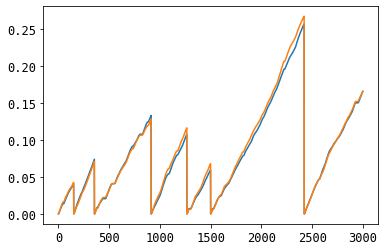

In [17]:
# 疲労度 left tired
df["left_mean_tired"].plot()
df["right_mean_tired"].plot()

ハーフとか試合が止まるごとに疲労度回復している？

## アクティブプレイヤーの行動分析

In [18]:
import collections
import pandas as pd
def action_counter_to_df(actions_log, name):
        
    actions_count = dict(collections.Counter(actions_log))
    
    # zero padding unselected action-options
    for i in list(actions_dict.keys()):
        if i in actions_count.keys():
            pass
        else:
            actions_count[i] = 0
    actions_count = sorted(actions_count.items(), key=lambda x:x[0])
    
    # convert key name(number(int) -> action_name(str))
    converted_actions_count = {}
    for key, count in actions_count:
        converted_key = actions_dict[key]
        converted_actions_count[converted_key] = count
    
    df = pd.DataFrame([list(converted_actions_count.keys()),list(converted_actions_count.values())], index=["action", name]).T

    return df

In [19]:
left_actions_log = []
right_actions_log = []

for i in range(1,3001,1):
    left_actions_log.append(output[i][0]["action"][0])
    right_actions_log.append(output[i][1]["action"][0])

left_action_df = action_counter_to_df(left_actions_log, 'left')
right_action_df = action_counter_to_df(right_actions_log, 'right')
action_df = pd.merge(left_action_df, right_action_df, on='action')
action_df

,action,left,right
0,idle,265,108
1,left,116,170
2,top_left,92,43
3,top,95,137
4,top_right,147,237
5,right,298,539
6,bottom_right,213,147
7,bottom,89,54
8,bottom_left,110,127
9,long_pass,206,34


In [20]:
import matplotlib.pyplot as plt
import seaborn as sns
def plot_action_count(df, col):
    fig, ax = plt.subplots(figsize=(7, 7), tight_layout=True)
    df_ = df[['action', col]].copy().sort_values(col, ascending=False)
    sns.barplot(x=df_[col], y=df_['action'])
    ax.set_title(f'count actions in a game ({col})', fontsize=15)
    ax.set_xlabel("Count", fontsize=15)
    ax.set_ylabel("Actions", fontsize=15)
    ax.tick_params(direction = "out", left=True, bottom=True)
    plt.tick_params(labelsize=15)
    # plt.savefig(f'output/{col}_action_count.png')
    return df_

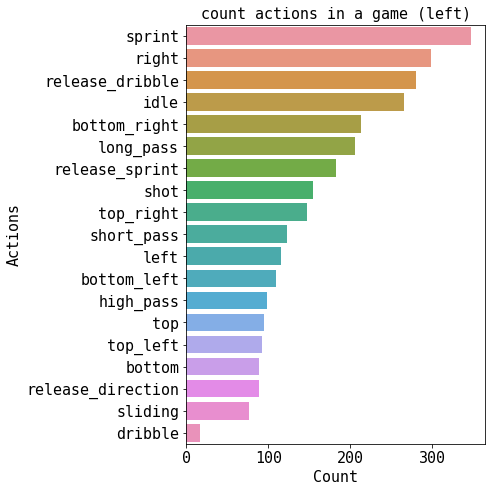

In [21]:
left_df = plot_action_count(action_df, 'left')

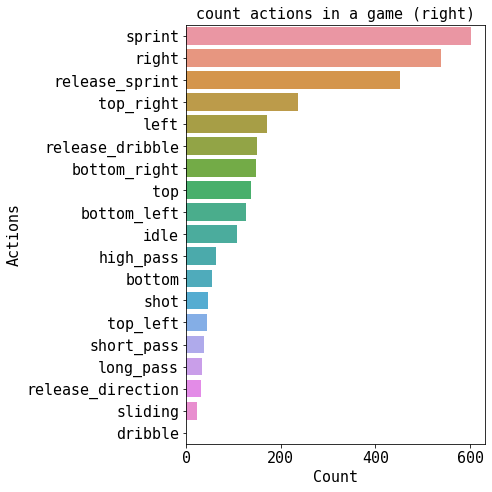

In [22]:
right_df = plot_action_count(action_df, 'right')

## レーダーチャートによる比較

In [23]:
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.patches import Circle, RegularPolygon
from matplotlib.path import Path
from matplotlib.projections.polar import PolarAxes
from matplotlib.projections import register_projection
from matplotlib.spines import Spine
from matplotlib.transforms import Affine2D


def radar_factory(num_vars, frame='circle'):
    """Create a radar chart with `num_vars` axes.

    This function creates a RadarAxes projection and registers it.

    Parameters
    ----------
    num_vars : int
        Number of variables for radar chart.
    frame : {'circle' | 'polygon'}
        Shape of frame surrounding axes.

    """
    # calculate evenly-spaced axis angles
    theta = np.linspace(0, 2*np.pi, num_vars, endpoint=False)

    class RadarAxes(PolarAxes):

        name = 'radar'
        # use 1 line segment to connect specified points
        RESOLUTION = 1

        def __init__(self, *args, **kwargs):
            super().__init__(*args, **kwargs)
            # rotate plot such that the first axis is at the top
            self.set_theta_zero_location('N')

        def fill(self, *args, closed=True, **kwargs):
            """Override fill so that line is closed by default"""
            return super().fill(closed=closed, *args, **kwargs)

        def plot(self, *args, **kwargs):
            """Override plot so that line is closed by default"""
            lines = super().plot(*args, **kwargs)
            for line in lines:
                self._close_line(line)

        def _close_line(self, line):
            x, y = line.get_data()
            # FIXME: markers at x[0], y[0] get doubled-up
            if x[0] != x[-1]:
                x = np.concatenate((x, [x[0]]))
                y = np.concatenate((y, [y[0]]))
                line.set_data(x, y)

        def set_varlabels(self, labels):
            self.set_thetagrids(np.degrees(theta), labels)

        def _gen_axes_patch(self):
            # The Axes patch must be centered at (0.5, 0.5) and of radius 0.5
            # in axes coordinates.
            if frame == 'circle':
                return Circle((0.5, 0.5), 0.5)
            elif frame == 'polygon':
                return RegularPolygon((0.5, 0.5), num_vars,
                                      radius=.5, edgecolor="k")
            else:
                raise ValueError("unknown value for 'frame': %s" % frame)

        def _gen_axes_spines(self):
            if frame == 'circle':
                return super()._gen_axes_spines()
            elif frame == 'polygon':
                # spine_type must be 'left'/'right'/'top'/'bottom'/'circle'.
                spine = Spine(axes=self,
                              spine_type='circle',
                              path=Path.unit_regular_polygon(num_vars))
                # unit_regular_polygon gives a polygon of radius 1 centered at
                # (0, 0) but we want a polygon of radius 0.5 centered at (0.5,
                # 0.5) in axes coordinates.
                spine.set_transform(Affine2D().scale(.5).translate(.5, .5)
                                    + self.transAxes)
                return {'polar': spine}
            else:
                raise ValueError("unknown value for 'frame': %s" % frame)

    register_projection(RadarAxes)
    return theta

In [24]:
whole_df = pd.merge(left_df, right_df, on="action")
whole_df

,action,left,right
0,sprint,347,602
1,right,298,539
2,release_dribble,280,150
3,idle,265,108
4,bottom_right,213,147
5,long_pass,206,34
6,release_sprint,183,451
7,shot,155,46
8,top_right,147,237
9,short_pass,123,37


In [25]:
# 右方向系の移動は全てdribbleとみなす
right = whole_df[whole_df["action"]=="right"].T.values
top_right = whole_df[whole_df["action"]=="top_right"].T.values
bottom_right = whole_df[whole_df["action"]=="bottom_right"].T.values
dribble = whole_df[whole_df["action"]=="dribble"].T.values

In [26]:
# dribbleの値を更新
whole_df = whole_df.T
whole_df[19] = right + top_right + bottom_right + dribble
whole_df = whole_df.T
whole_df

,action,left,right
0,sprint,347,602
1,right,298,539
2,release_dribble,280,150
3,idle,265,108
4,bottom_right,213,147
5,long_pass,206,34
6,release_sprint,183,451
7,shot,155,46
8,top_right,147,237
9,short_pass,123,37


In [27]:
# 必要な行動のみ取り出す
dribble_action = 'righttop_rightbottom_rightdribble'
use_actions = ["sprint", "long_pass", "short_pass", "high_pass", "shot", "sliding", dribble_action]
radar_df = whole_df[whole_df["action"].isin(use_actions)]
radar_df = radar_df.replace(dribble_action,"dribble")
radar_df

,action,left,right
0,sprint,347,602
5,long_pass,206,34
7,shot,155,46
9,short_pass,123,37
12,high_pass,99,63
17,sliding,76,23
19,dribble,675,923


In [28]:
# 正規化
radar_df['left'] = radar_df['left'] / radar_df['left'].sum()
radar_df['right'] = radar_df['right'] / radar_df['right'].sum()
radar_df

,action,left,right
0,sprint,0.206425,0.348380
5,long_pass,0.122546,0.019676
7,shot,0.092207,0.026620
9,short_pass,0.073171,0.021412
12,high_pass,0.058894,0.036458
17,sliding,0.045211,0.013310
19,dribble,0.401547,0.534144


In [29]:
data = radar_df.iloc[:, 1:].T.values
data

array([[0.20642475, 0.1225461 , 0.09220702, 0.07317073, 0.05889352,
        0.04521118, 0.4015467 ],
       [0.34837963, 0.01967593, 0.02662037, 0.02141204, 0.03645833,
        0.01331019, 0.53414352]])

In [30]:
N = 7
theta = radar_factory(N)
theta

array([0.        , 0.8975979 , 1.7951958 , 2.6927937 , 3.5903916 ,
       4.48798951, 5.38558741])

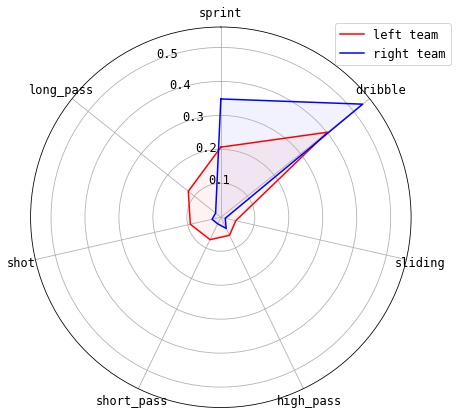

In [31]:
fig, ax = plt.subplots(figsize=(7, 7), nrows=1, ncols=1,
                         subplot_kw=dict(projection='radar'))
# plt.rcParams['font.size'] = 12
colors = ['r', 'b']

for d, color in zip(data, colors):
    ax.plot(theta, d, color=color)
    ax.fill(theta, d, facecolor=color, alpha=0.05)
ax.set_varlabels(radar_df["action"].values)

# add legend relative to top-left plot
labels = ['left team', 'right team']
legend = ax.legend(labels, loc=(0.8, 0.9))
# plt.savefig('output/radarchart.png')
plt.show()

## ボールのトラッキング

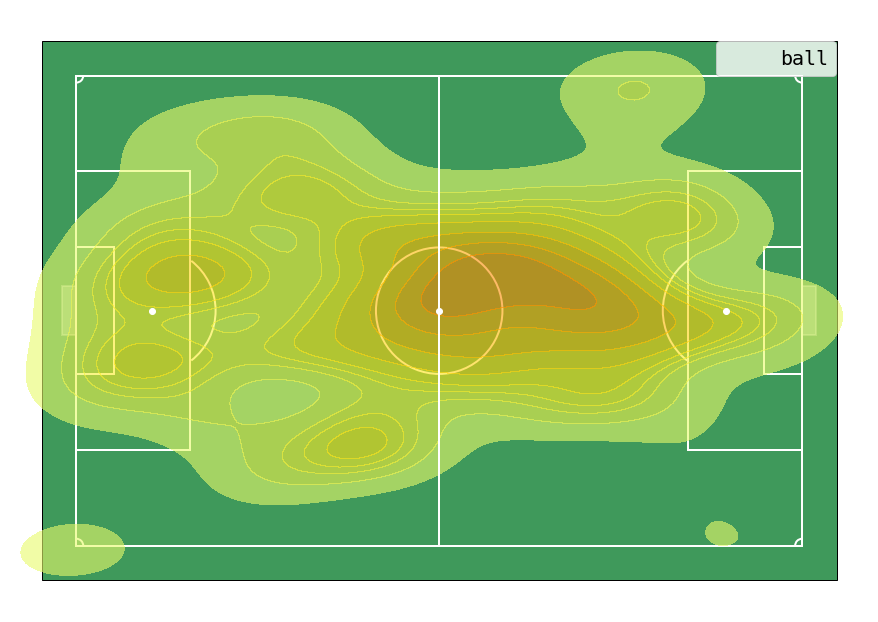

In [32]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()
sns.kdeplot(x=visualizer.scale_x(df["ball_x"]), y=visualizer.scale_y(df["ball_y"]), cmap='Wistia', zorder=2, fill=True,ax=ax, label="ball", alpha=0.6)      
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20, loc=(0.82, 0.885))
# plt.savefig('output/ball_tracking_map.png')

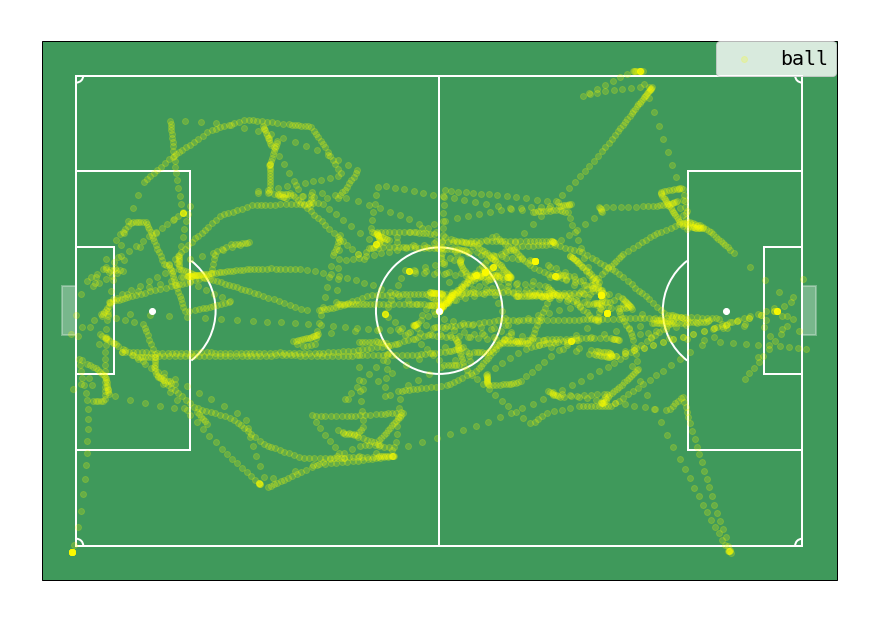

In [33]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()
ax.scatter(visualizer.scale_x(df["ball_x"]), visualizer.scale_y(df["ball_y"]), zorder=2, color="yellow", alpha=0.2, label='ball')
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20, loc=(0.82, 0.885))
# plt.savefig('output/ball_tracking.png')

## 選手のトラッキング

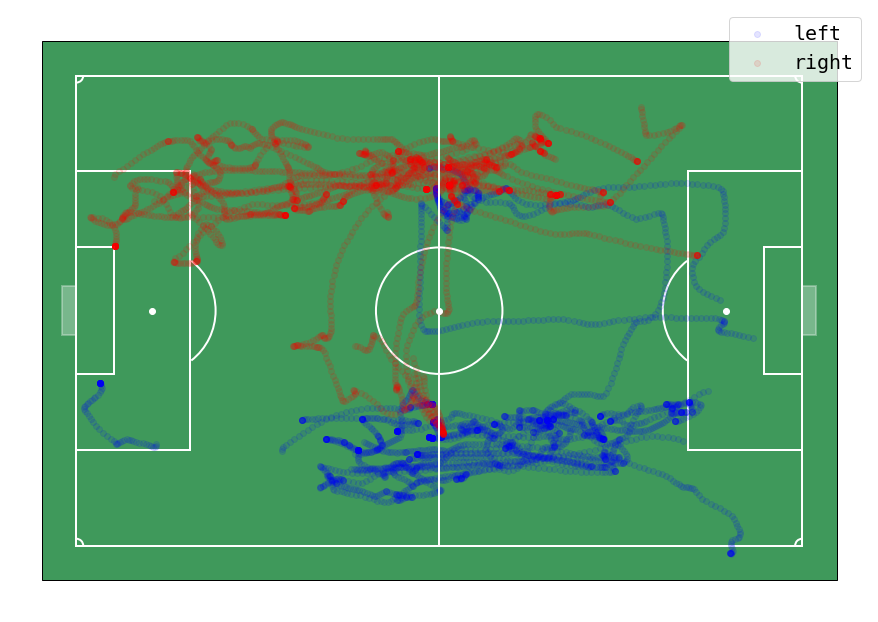

In [34]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()
target = 10
for i in range(11):
    if i in [target]:  # 対象選手を指定ここでは10番
        left_x = df[f"left_player{i}_x"]
        left_y = df[f"left_player{i}_y"]
        ax.scatter(visualizer.scale_x(left_x), visualizer.scale_y(left_y), zorder=2, color="blue", alpha=0.1, label="left")
        
        right_x = df[f"right_player{i}_x"]
        right_y = df[f"right_player{i}_y"]
        ax.scatter(visualizer.scale_x(right_x), visualizer.scale_y(right_y), zorder=2, color="red", alpha=0.1, label='right')

fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20)
# plt.savefig(f'output/p{target}_tracking.png')

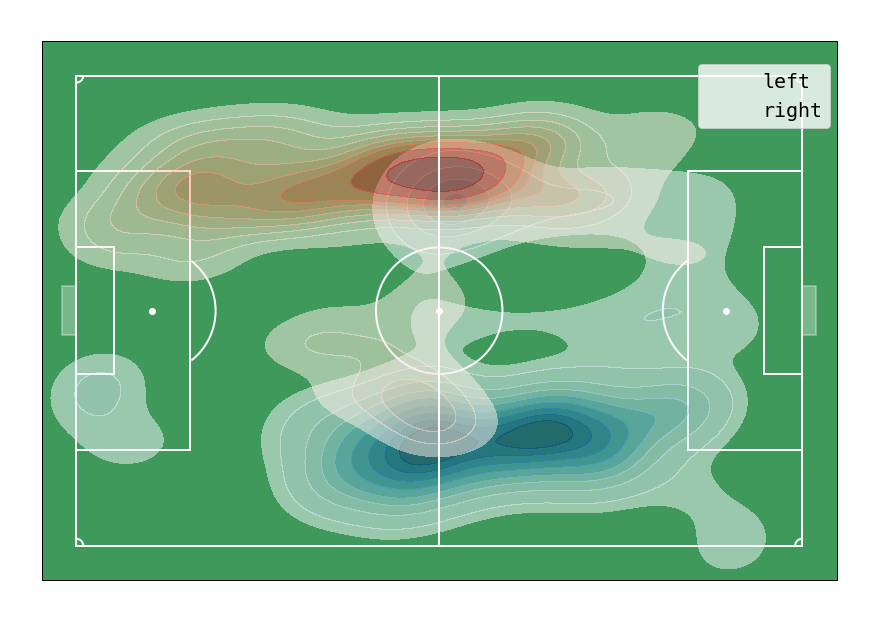

In [35]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()

for i in range(11):
    if i in [target]:
        left_x = df[f"left_player{i}_x"]
        left_y = df[f"left_player{i}_y"]
        sns.kdeplot(x=visualizer.scale_x(left_x), y=visualizer.scale_y(left_y), cmap='Blues', zorder=2, fill=True,ax=ax, label="left", alpha=0.5)
        
        right_x = df[f"right_player{i}_x"]
        right_y = df[f"right_player{i}_y"]
        sns.kdeplot(x=visualizer.scale_x(right_x), y=visualizer.scale_y(right_y), cmap='Reds', zorder=2, fill=True,ax=ax, label="right", alpha=0.5)

fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20, loc=[0.8, 0.8])
# plt.savefig(f'output/p{target}_mapping.png')

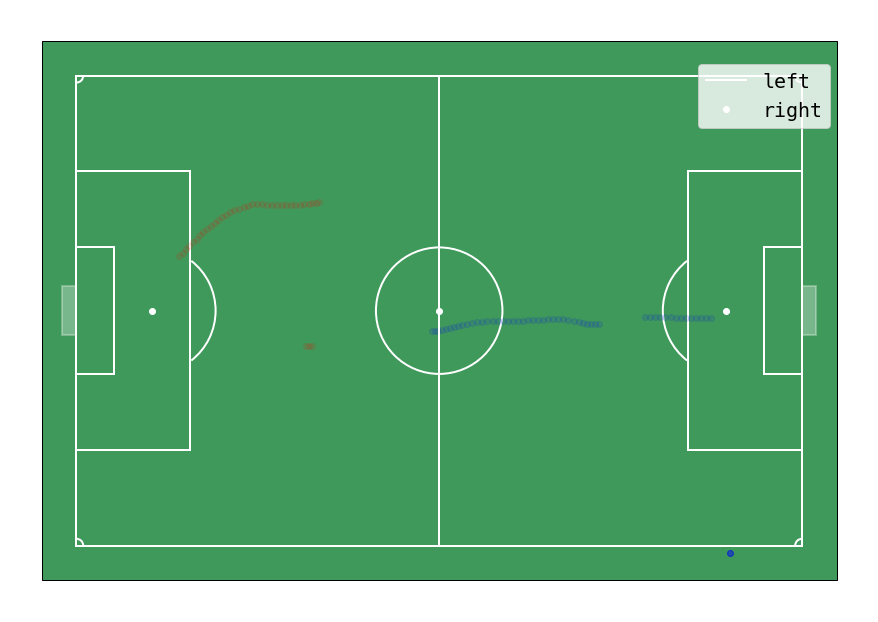

In [36]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()
for i in range(11):
    if i in [target]:
        left_x = df[df['left_ball_owned_player']==i][f'left_player{i}_x']
        left_y = df[df['left_ball_owned_player']==i][f'left_player{i}_y']
        ax.scatter(visualizer.scale_x(left_x), visualizer.scale_y(left_y), zorder=2, color="blue", alpha=0.1, label='left')
        right_x = df[df['right_ball_owned_player']==i][f'right_player{i}_x']
        right_y = df[df['right_ball_owned_player']==i][f'right_player{i}_y']
        ax.scatter(visualizer.scale_x(right_x), visualizer.scale_y(right_y), zorder=2, color="red", alpha=0.1, label='right')

fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(['left', 'right'], fontsize=20, loc=(0.8,0.8))
# plt.savefig(f'output/p{target}_touch_tracking.png')

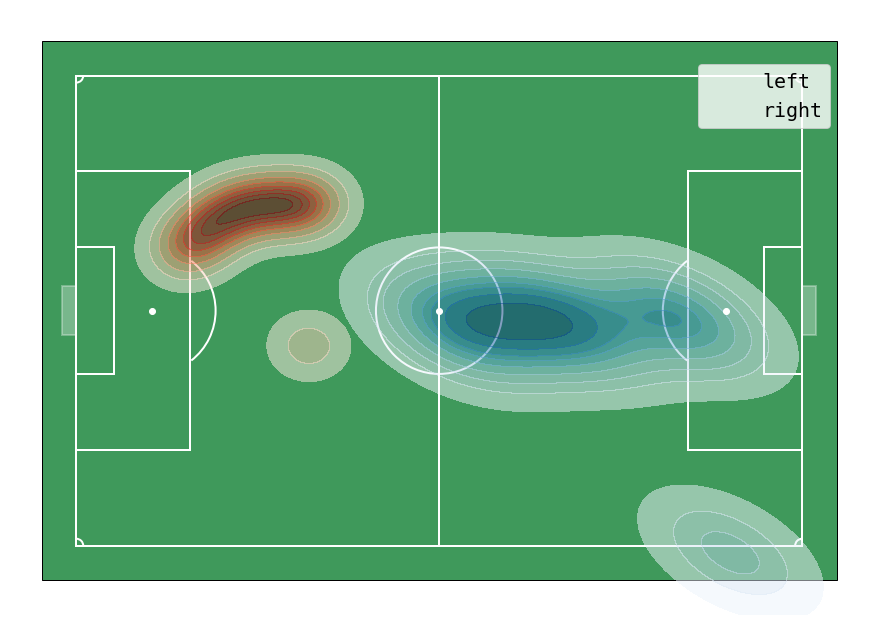

In [37]:
from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()

for i in range(11):
    if i in [10]:
        left_x = df[df['left_ball_owned_player']==i][f'left_player{i}_x']
        left_y = df[df['left_ball_owned_player']==i][f'left_player{i}_y']
        sns.kdeplot(x=visualizer.scale_x(left_x), y=visualizer.scale_y(left_y), cmap='Blues', zorder=2, fill=True,ax=ax, label="left", alpha=0.5)
        
        right_x = df[df['right_ball_owned_player']==i][f'right_player{i}_x']
        right_y = df[df['right_ball_owned_player']==i][f'right_player{i}_y']
        sns.kdeplot(x=visualizer.scale_x(right_x), y=visualizer.scale_y(right_y), cmap='Reds', zorder=2, fill=True,ax=ax, label="right", alpha=0.5)
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20, loc=[0.8, 0.8])
# plt.savefig(f'output/p{target}_touch_mapping.png')

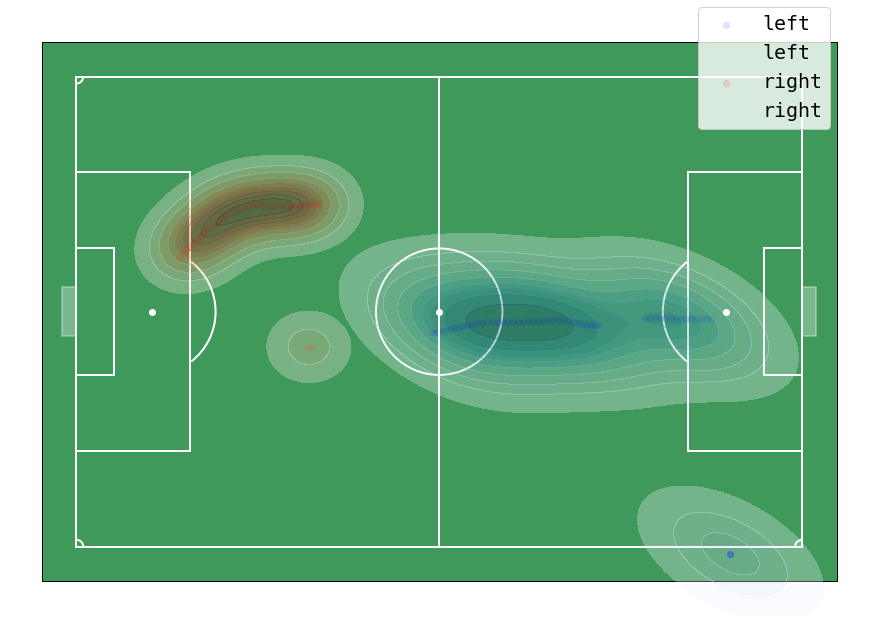

In [38]:

from src import visualizer
fig, ax = visualizer.initFigure()
visualizer.drawPitch(ax)
ax.invert_yaxis()

for i in range(11):
    if i in [target]:
        left_x = df[df['left_ball_owned_player']==i][f'left_player{i}_x']
        left_y = df[df['left_ball_owned_player']==i][f'left_player{i}_y']
        ax.scatter(visualizer.scale_x(left_x), visualizer.scale_y(left_y), zorder=2, color="blue", alpha=0.1, label='left')
        sns.kdeplot(x=visualizer.scale_x(left_x), y=visualizer.scale_y(left_y), cmap='Blues', zorder=2, fill=True,ax=ax, label="left", alpha=0.3)
        
        right_x = df[df['right_ball_owned_player']==i][f'right_player{i}_x']
        right_y = df[df['right_ball_owned_player']==i][f'right_player{i}_y']
        ax.scatter(visualizer.scale_x(right_x), visualizer.scale_y(right_y), zorder=2, color="red", alpha=0.1, label='right')
        sns.kdeplot(x=visualizer.scale_x(right_x), y=visualizer.scale_y(right_y), cmap='Reds', zorder=2, fill=True,ax=ax, label="right", alpha=0.3)
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
ax.legend(fontsize=20, loc=[0.8, 0.8])
# plt.savefig(f'output/p{target}_touch_mix.png')